# Installing Segment Anything Model (SAM)

In [1]:
!pip install git+https://github.com/facebookresearch/segment-anything.git
!pip install opencv-python matplotlib numpy nibabel

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-7dfw67xj
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-7dfw67xj
  Resolved https://github.com/facebookresearch/segment-anything.git to commit dca509fe793f601edb92606367a655c15ac00fdf
  Preparing metadata (setup.py) ... done


# Importing Libraries

In [2]:
import numpy as np
import pandas as pd
import os
import cv2
import nibabel as nib
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from segment_anything import sam_model_registry, SamPredictor

# Defining Datasets Paths

In [3]:
base_dir = '/kaggle/input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData'
data_list = []

for patient_id in sorted(os.listdir(base_dir)):
    if patient_id == 'BraTS20_Training_355':
        continue  # 🚫 Skip this folder

    patient_path = os.path.join(base_dir, patient_id)
    if os.path.isdir(patient_path):
        data_entry = {
            'patient_id': patient_id,
            'flair': os.path.join(patient_path, f'{patient_id}_flair.nii'),
            't1': os.path.join(patient_path, f'{patient_id}_t1.nii'),
            't1ce': os.path.join(patient_path, f'{patient_id}_t1ce.nii'),
            't2': os.path.join(patient_path, f'{patient_id}_t2.nii'),
            'seg': os.path.join(patient_path, f'{patient_id}_seg.nii')
        }
        data_list.append(data_entry)

train_df = pd.DataFrame(data_list)

# Splitting Dataset into Training & Validation

In [4]:
train_df, valid_df = train_test_split(
    train_df,
    test_size=0.2,      # 20% for testing
    random_state=42,    # for reproducibility
    shuffle=True        # shuffle before splitting
)

# Optional: reset indices if you want tidy DataFrames
train_df = train_df.reset_index(drop=True)
valid_df = valid_df.reset_index(drop=True)

# Show the shapes
print("Train shape:", train_df.shape)
print("Test shape:", valid_df.shape)

# Show the first few rows of each set
print(train_df.head())

Train shape: (294, 6)
Test shape: (74, 6)
             patient_id                                              flair  \
0  BraTS20_Training_350  /kaggle/input/brats20-dataset-training-validat...   
1  BraTS20_Training_308  /kaggle/input/brats20-dataset-training-validat...   
2  BraTS20_Training_076  /kaggle/input/brats20-dataset-training-validat...   
3  BraTS20_Training_085  /kaggle/input/brats20-dataset-training-validat...   
4  BraTS20_Training_358  /kaggle/input/brats20-dataset-training-validat...   

                                                  t1  \
0  /kaggle/input/brats20-dataset-training-validat...   
1  /kaggle/input/brats20-dataset-training-validat...   
2  /kaggle/input/brats20-dataset-training-validat...   
3  /kaggle/input/brats20-dataset-training-validat...   
4  /kaggle/input/brats20-dataset-training-validat...   

                                                t1ce  \
0  /kaggle/input/brats20-dataset-training-validat...   
1  /kaggle/input/brats20-dataset-trainin

In [5]:
print(valid_df.head())

             patient_id                                              flair  \
0  BraTS20_Training_166  /kaggle/input/brats20-dataset-training-validat...   
1  BraTS20_Training_034  /kaggle/input/brats20-dataset-training-validat...   
2  BraTS20_Training_016  /kaggle/input/brats20-dataset-training-validat...   
3  BraTS20_Training_313  /kaggle/input/brats20-dataset-training-validat...   
4  BraTS20_Training_058  /kaggle/input/brats20-dataset-training-validat...   

                                                  t1  \
0  /kaggle/input/brats20-dataset-training-validat...   
1  /kaggle/input/brats20-dataset-training-validat...   
2  /kaggle/input/brats20-dataset-training-validat...   
3  /kaggle/input/brats20-dataset-training-validat...   
4  /kaggle/input/brats20-dataset-training-validat...   

                                                t1ce  \
0  /kaggle/input/brats20-dataset-training-validat...   
1  /kaggle/input/brats20-dataset-training-validat...   
2  /kaggle/input/brats20-d

# Visualizing Patients Modalities

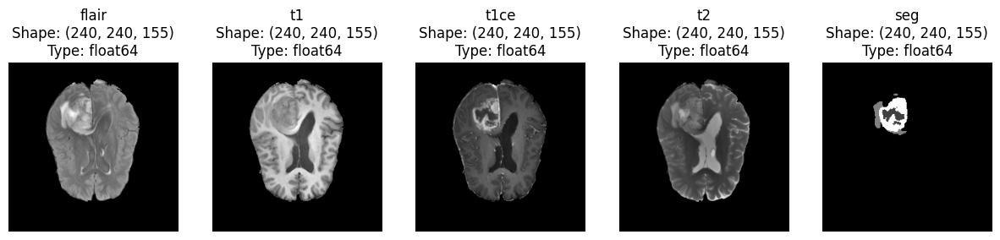

In [6]:
def visualize_patient_modalities(row):
    """Visualizes Flair, T1, T1ce, T2, and Segmentation slices with metadata."""
    modalities = ['flair', 't1', 't1ce', 't2', 'seg']
    
    plt.figure(figsize=(15, 3))
    
    for idx, modality in enumerate(modalities):
        # Load the .nii file
        nii_file = nib.load(row[modality])
        data = nii_file.get_fdata()
        
        # Get metadata
        shape = data.shape
        dtype = data.dtype
        
        # Take the middle slice
        slice_idx = shape[2] // 2
        slice_img = data[:, :, slice_idx]
        
        # Plot the slice
        plt.subplot(1, 5, idx + 1)
        plt.imshow(slice_img.T, cmap='gray', origin='lower')
        plt.title(f"{modality}\nShape: {shape}\nType: {dtype}")
        plt.axis('off')
        
    plt.show()

# Example: Visualize first patient in train_df
visualize_patient_modalities(train_df.iloc[0])

# Image Slicing for SAM

In [7]:
def prepare_slices_for_sam(nii_path, output_dir, modality_name):
    os.makedirs(output_dir, exist_ok=True)
    nii = nib.load(nii_path)
    data = nii.get_fdata()
    
    for i in range(data.shape[2]):  # Iterate over all axial slices
        slice_img = data[:, :, i]
        
        # Normalize to 0-255 and convert to uint8
        norm_img = cv2.normalize(slice_img, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
        
        # Convert to RGB (SAM requires 3 channels)
        rgb_img = cv2.cvtColor(norm_img, cv2.COLOR_GRAY2RGB)
        
        # Save as PNG
        save_path = os.path.join(output_dir, f'{modality_name}_slice_{i}.png')
        cv2.imwrite(save_path, rgb_img)

In [8]:
modalities = ['flair', 't1', 't1ce', 't2']
for modality in modalities:
    prepare_slices_for_sam(train_df.iloc[0][modality], f'./prepared_slices/{modality}', modality_name=modality)

# Visualizing all Slices

Visualizing flair - Shape: (240, 240, 155) - Slices: 155


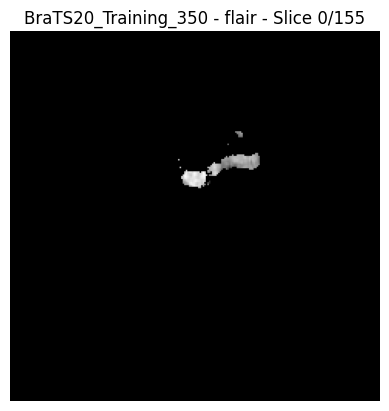

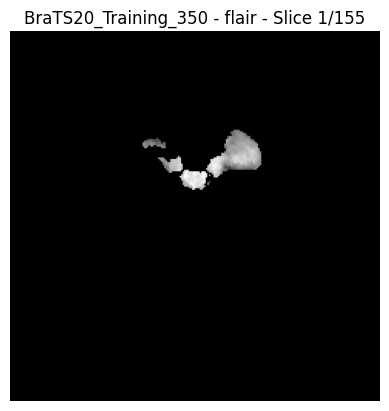

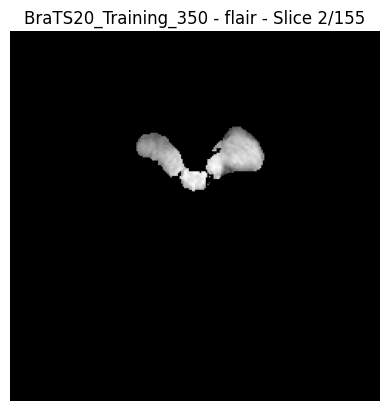

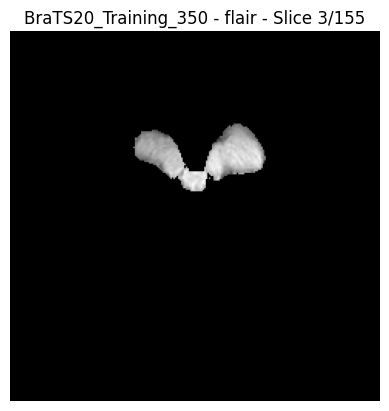

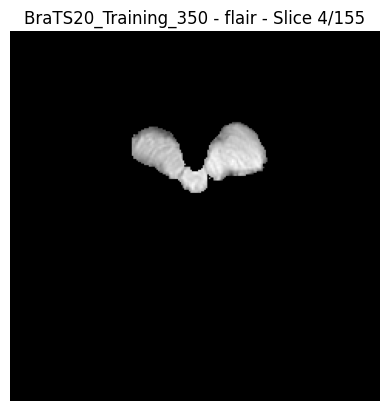

...

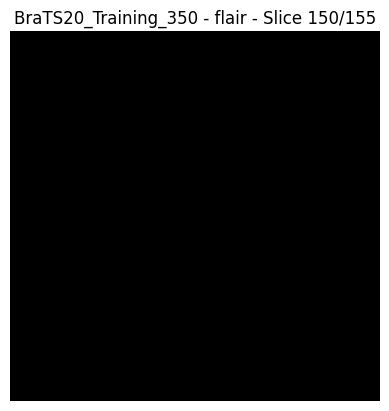

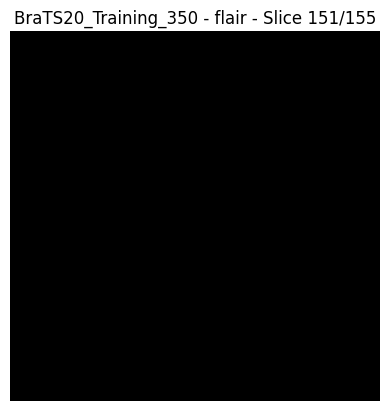

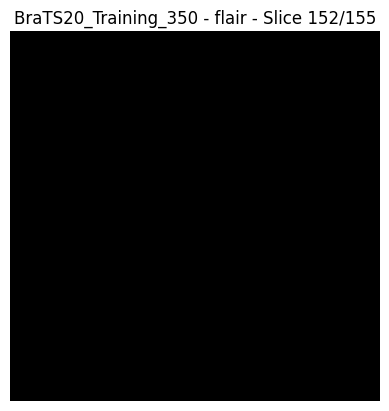

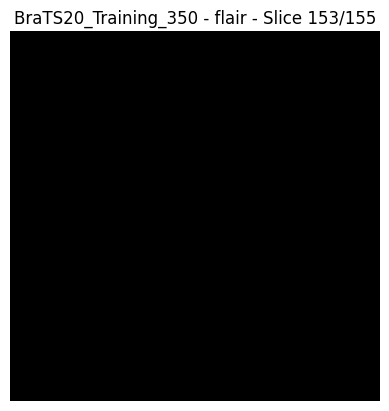

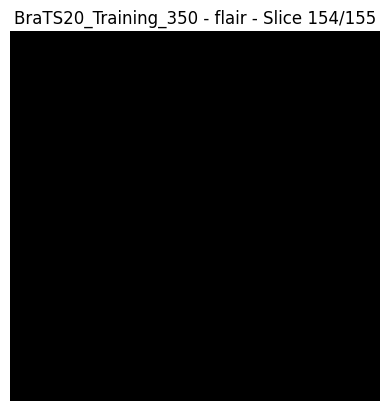

Visualizing t1 - Shape: (240, 240, 155) - Slices: 155


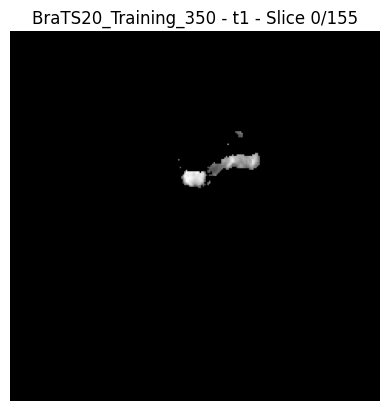

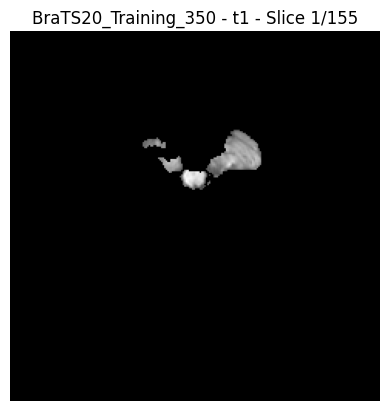

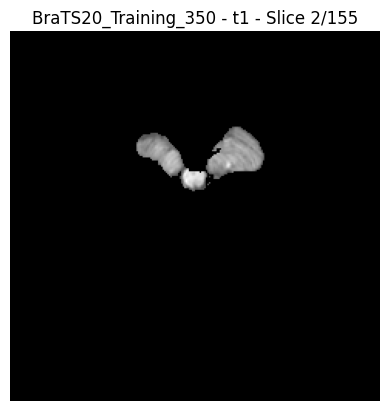

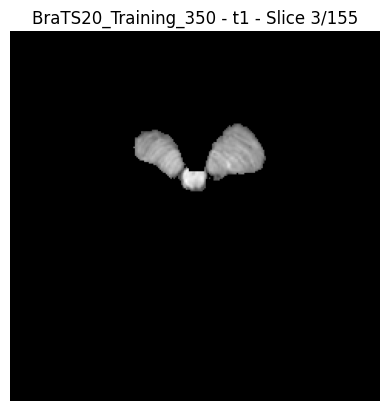

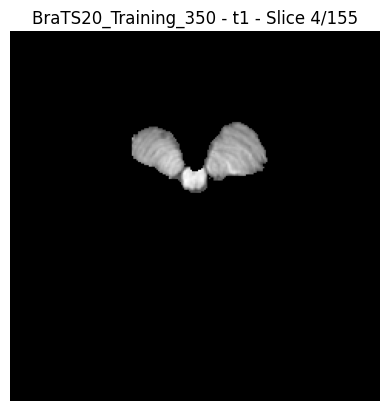

...

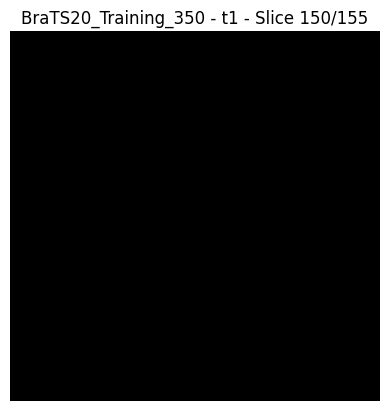

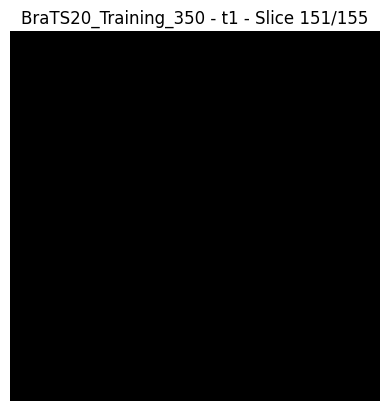

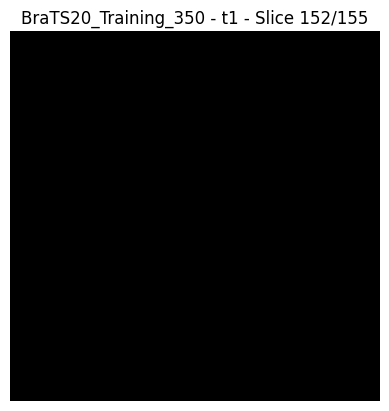

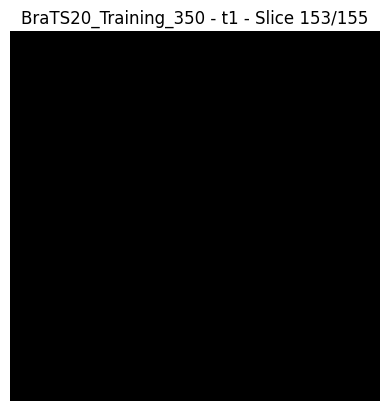

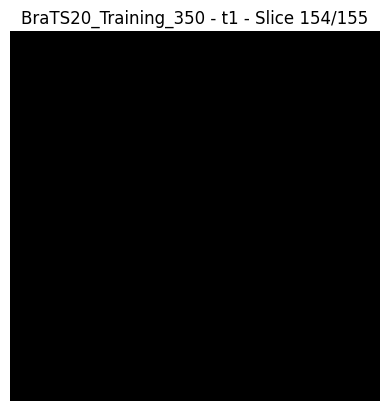

Visualizing t1ce - Shape: (240, 240, 155) - Slices: 155


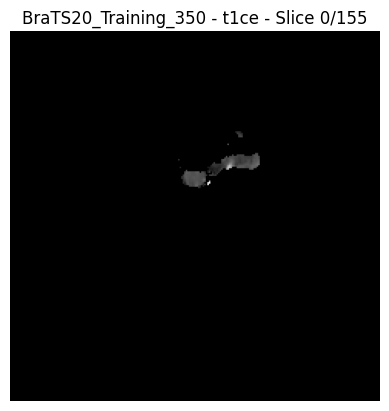

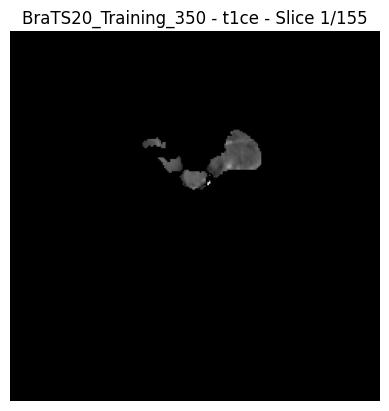

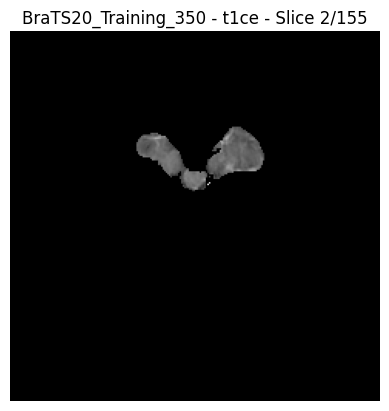

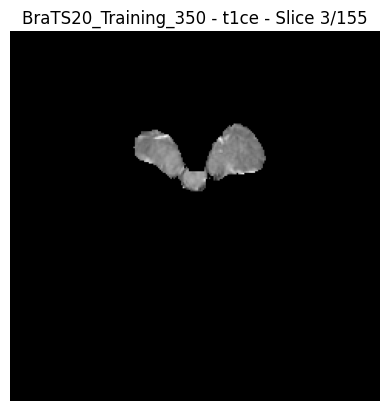

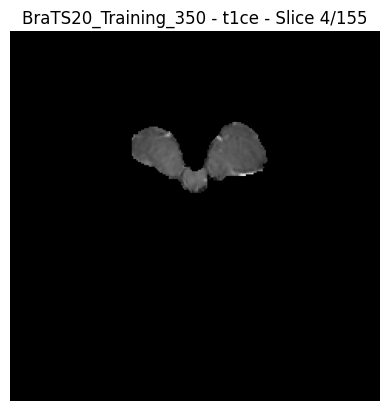

...

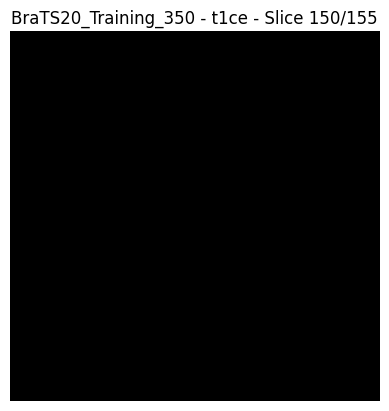

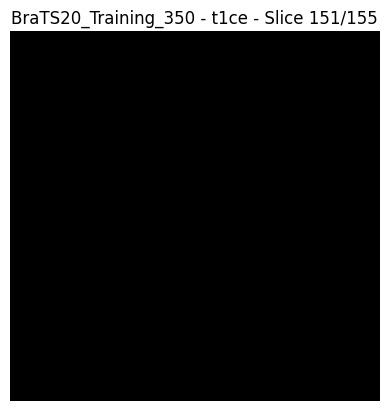

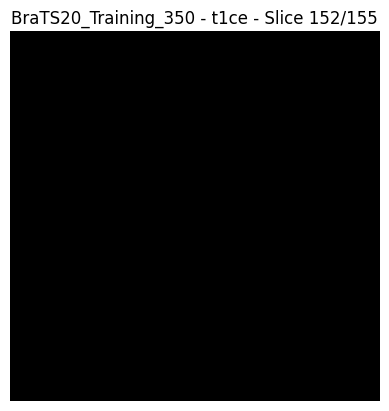

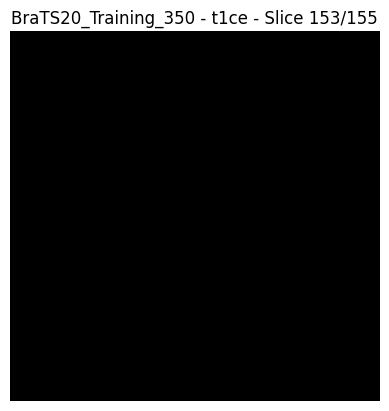

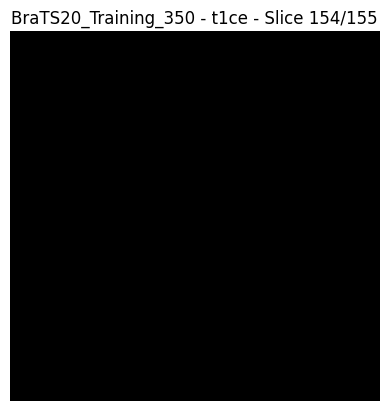

Visualizing t2 - Shape: (240, 240, 155) - Slices: 155


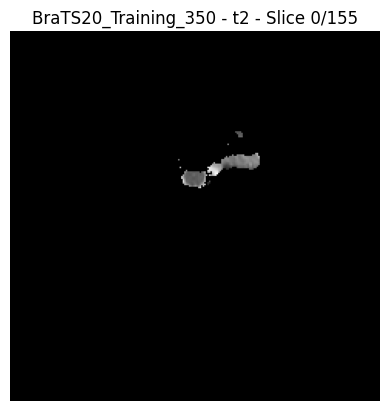

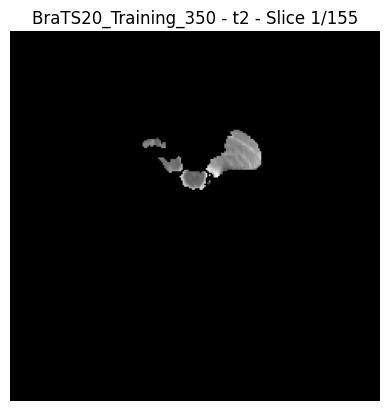

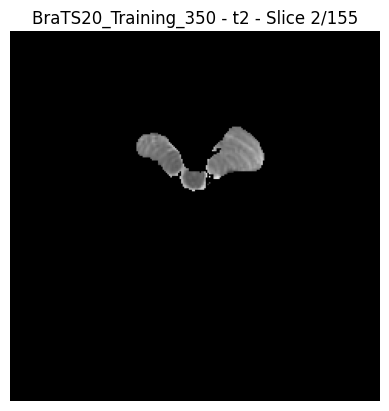

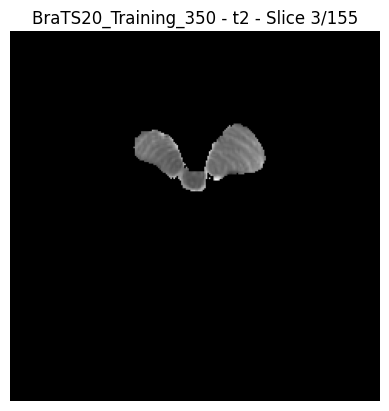

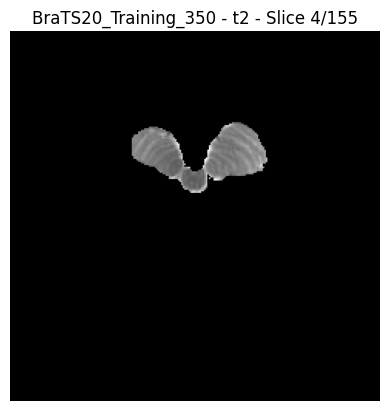

...

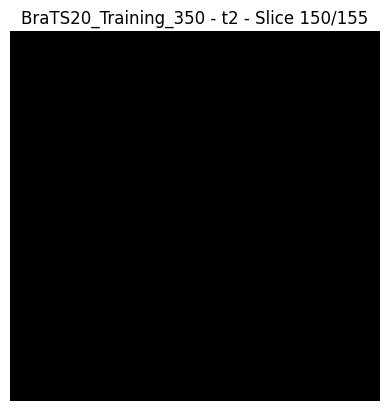

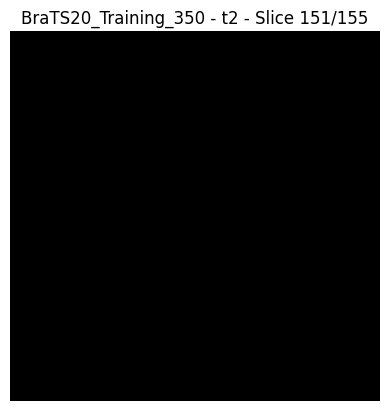

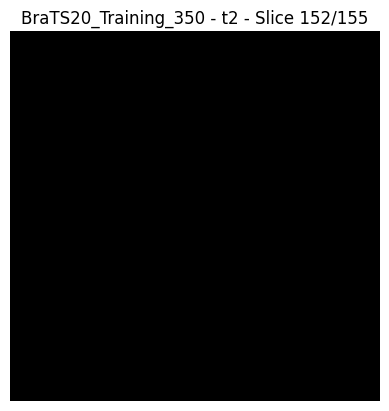

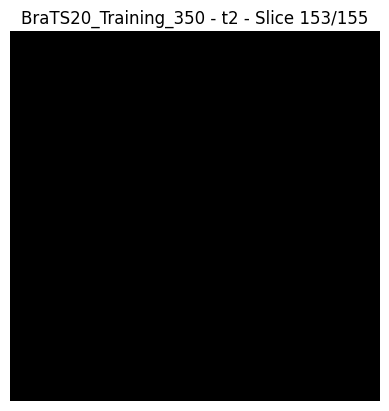

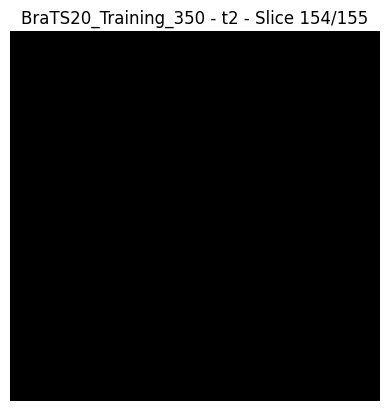

Visualizing seg - Shape: (240, 240, 155) - Slices: 155


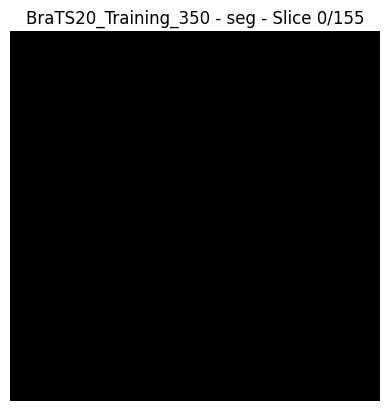

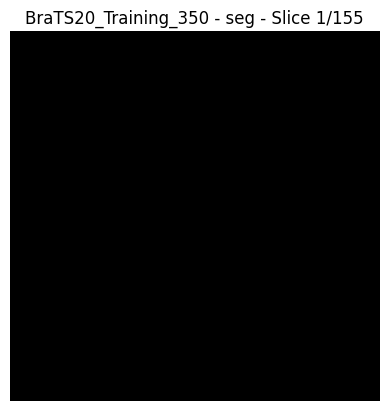

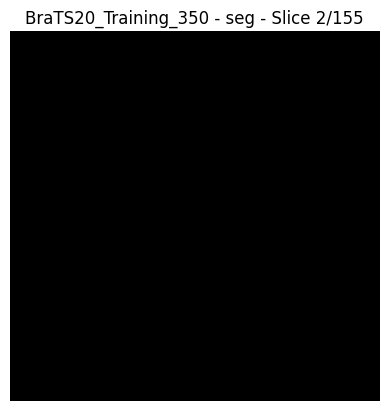

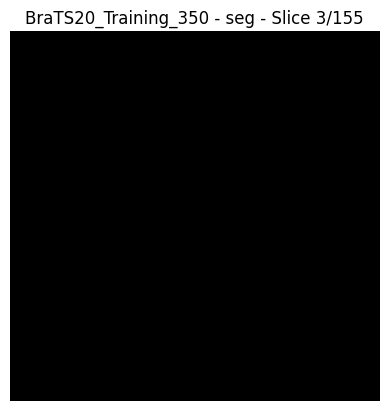

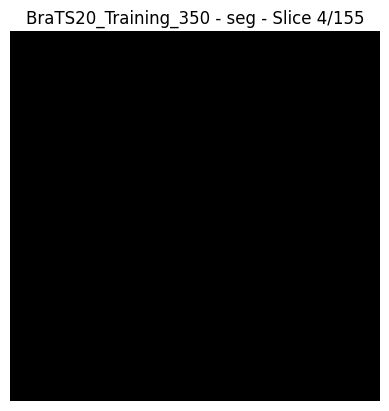

...

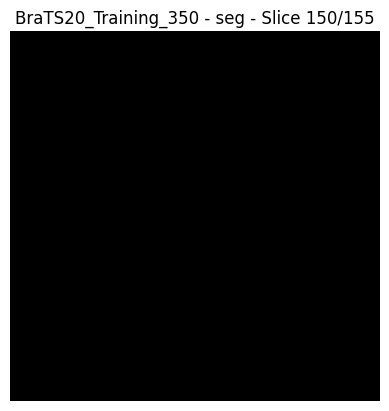

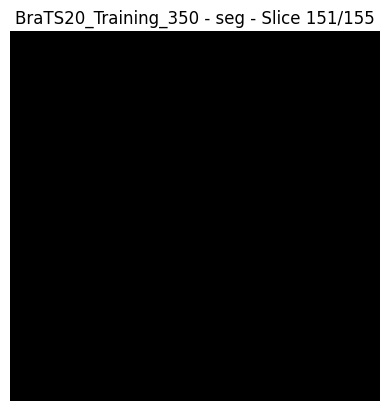

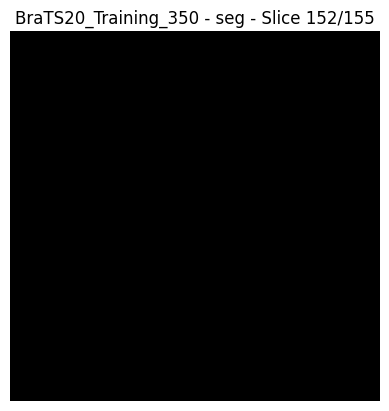

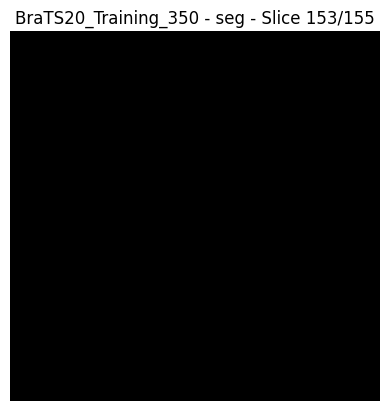

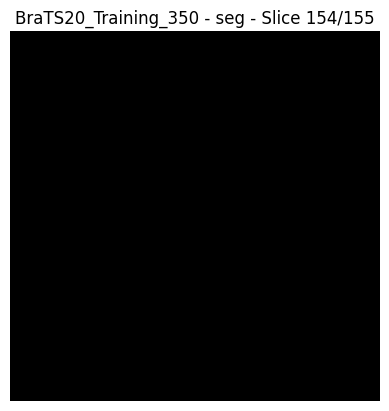

In [9]:
def visualize_all_slices(row):
    """
    Visualizes all axial slices for each modality of a single patient.
    Displays them in separate figures per modality.
    """
    modalities = ['flair', 't1', 't1ce', 't2', 'seg']

    for modality in modalities:
        nii_file = nib.load(row[modality])
        data = nii_file.get_fdata()
        
        num_slices = data.shape[2]
        print(f"Visualizing {modality} - Shape: {data.shape} - Slices: {num_slices}")
        
        # Visualize all slices
        for i in range(num_slices):
            slice_img = data[:, :, i]
            plt.imshow(slice_img.T, cmap='gray', origin='lower')
            plt.title(f"{row['patient_id']} - {modality} - Slice {i}/{num_slices}")
            plt.axis('off')
            plt.show()

# Example: Visualize all slices of first patient
visualize_all_slices(train_df.iloc[0])

# Defining SAM Variant

In [10]:
checkpoint_path = '/kaggle/input/sam-vit-h-4b8939-pth/sam_vit_h_4b8939.pth'  # Adjust path if needed
model_type = "vit_h"

sam = sam_model_registry[model_type](checkpoint=checkpoint_path)
predictor = SamPredictor(sam)

# Defining Boundary Box Mechanism from Masks

In [11]:
def get_bounding_box_from_mask(mask):
    """Returns bounding box [x_min, y_min, x_max, y_max] for a binary mask."""
    y_indices, x_indices = np.where(mask > 0)
    if len(x_indices) == 0 or len(y_indices) == 0:
        return None
    x_min, x_max = x_indices.min(), x_indices.max()
    y_min, y_max = y_indices.min(), y_indices.max()
    return [x_min, y_min, x_max, y_max]

# Extracting Ground Truth Mask & SAM Mask by Processing Slices

In [12]:
def process_slice_with_gt(row, modality='flair', slice_index=77):
    """Processes a slice using a bounding box derived from ground truth mask."""
    # Load NIfTI images
    img_nii = nib.load(row[modality])
    img_data = img_nii.get_fdata()
    slice_img = img_data[:, :, slice_index]
    
    # Load ground truth segmentation mask
    seg_nii = nib.load(row['seg'])
    seg_data = seg_nii.get_fdata()
    gt_mask = (seg_data[:, :, slice_index] > 0).astype(np.uint8)
    
    # Get bounding box from ground truth
    bbox = get_bounding_box_from_mask(gt_mask)
    if bbox is None:
        print(f"No tumor in slice {slice_index} of {row['patient_id']}. Skipping.")
        return None

    # Prepare image for SAM
    norm_img = cv2.normalize(slice_img, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    rgb_img = cv2.cvtColor(norm_img, cv2.COLOR_GRAY2RGB)

    predictor.set_image(rgb_img)
    masks, scores, _ = predictor.predict(box=np.array([bbox]))
    sam_mask = masks[0]

    # Visualization: side-by-side (original, ground truth, SAM mask)
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    
    axs[0].imshow(rgb_img, cmap='gray')
    axs[0].set_title('Original Image')
    axs[0].axis('off')
    
    axs[1].imshow(rgb_img, cmap='gray')
    axs[1].imshow(gt_mask, cmap='hot', alpha=0.5)
    axs[1].set_title('Ground Truth Mask')
    axs[1].axis('off')
    
    axs[2].imshow(rgb_img, cmap='gray')
    axs[2].imshow(sam_mask, cmap='cividis', alpha=0.5)
    axs[2].set_title(f'SAM\nScore: {scores[0]:.2f}')
    axs[2].axis('off')
    
    plt.suptitle(f"{row['patient_id']} - {modality} - Slice {slice_index}")
    plt.tight_layout()
    plt.show()

    return gt_mask, sam_mask

# Calculating Dice Coefficient/Score between Ground Truth Mask and SAM Generated Mask

In [13]:
def calculate_dice(mask1, mask2):
    """
    Calculates Dice coefficient between two binary masks.
    Both masks should have the same shape and dtype=bool or 0/1.
    """
    mask1 = mask1.astype(bool)
    mask2 = mask2.astype(bool)

    intersection = np.logical_and(mask1, mask2).sum()
    total = mask1.sum() + mask2.sum()
    if total == 0:
        return 1.0  # If both masks are empty, define Dice as perfect (1.0)
    dice = 2 * intersection / total
    return dice

# Calculating Intersection over Union (IoU) between Ground Truth Mask and SAM Generated Mask

In [14]:
import numpy as np

def calculate_iou(mask1, mask2):
    """
    Calculates Intersection over Union (IoU) between two binary masks.
    Both masks should have the same shape and dtype=bool or 0/1.
    """
    mask1 = mask1.astype(bool)
    mask2 = mask2.astype(bool)

    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    if union == 0:
        return 0.0  # Avoid division by zero
    iou = intersection / union
    return iou

# Implementing SAM on Training Dataset & Visualizing Ground Truth Mask along with SAM Generated Masks

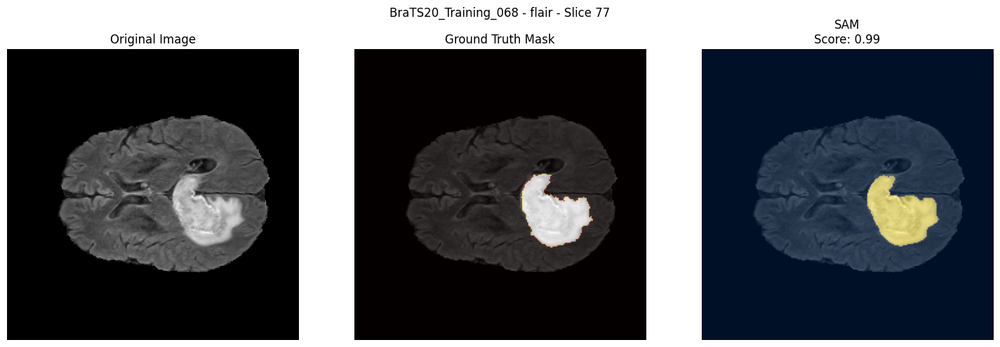

Dice Score: 0.9535 | IoU: 0.9111


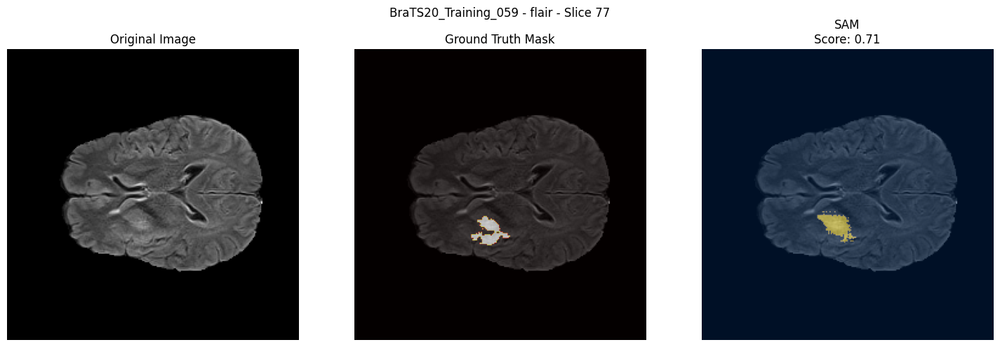

Dice Score: 0.5351 | IoU: 0.3652


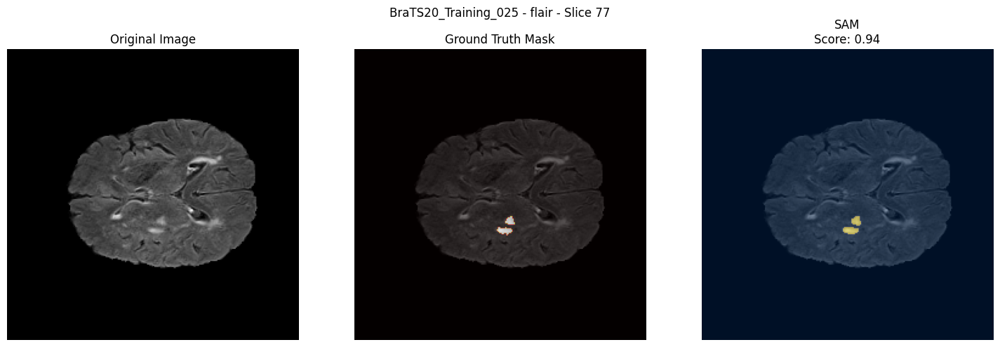

Dice Score: 0.8155 | IoU: 0.6885


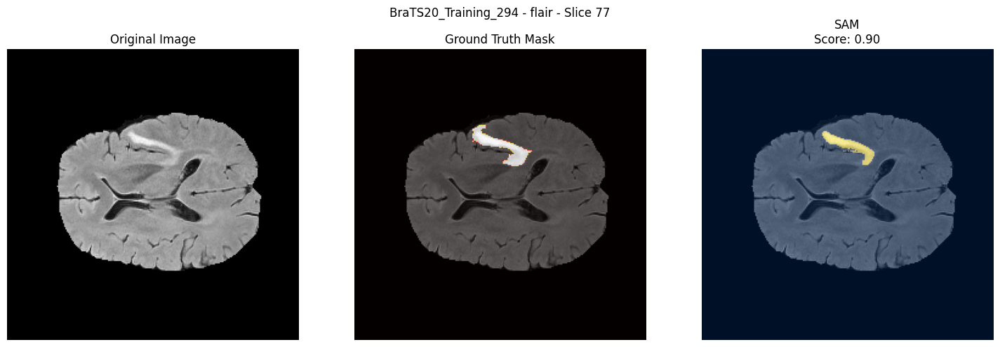

Dice Score: 0.7680 | IoU: 0.6234
No tumor in slice 77 of BraTS20_Training_325. Skipping.


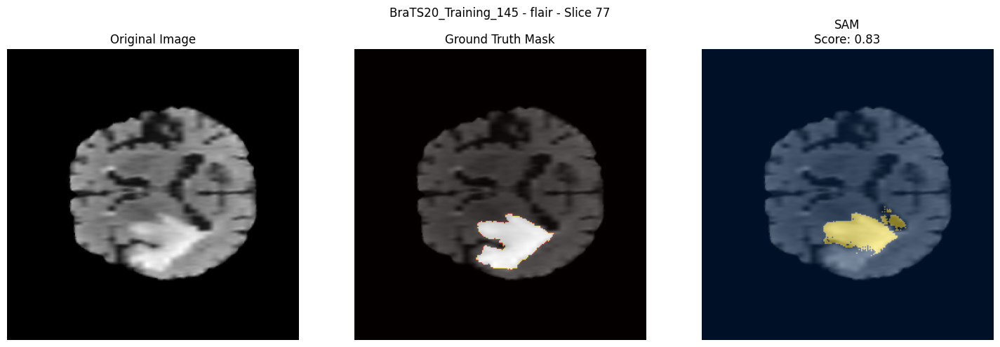

Dice Score: 0.6927 | IoU: 0.5299
No tumor in slice 77 of BraTS20_Training_105. Skipping.


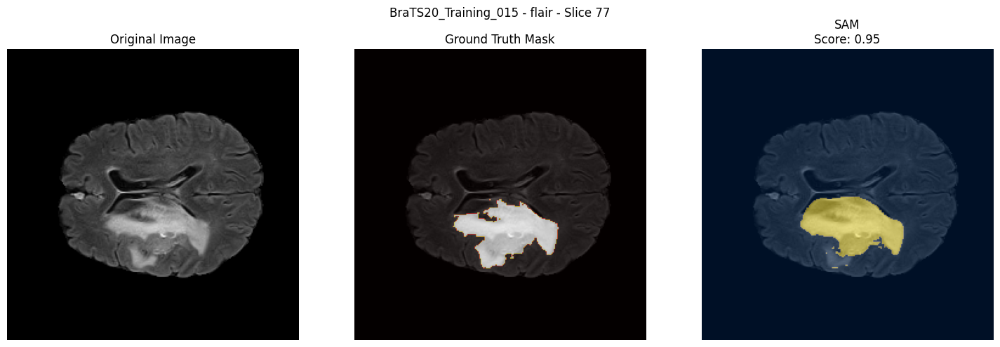

Dice Score: 0.8221 | IoU: 0.6979


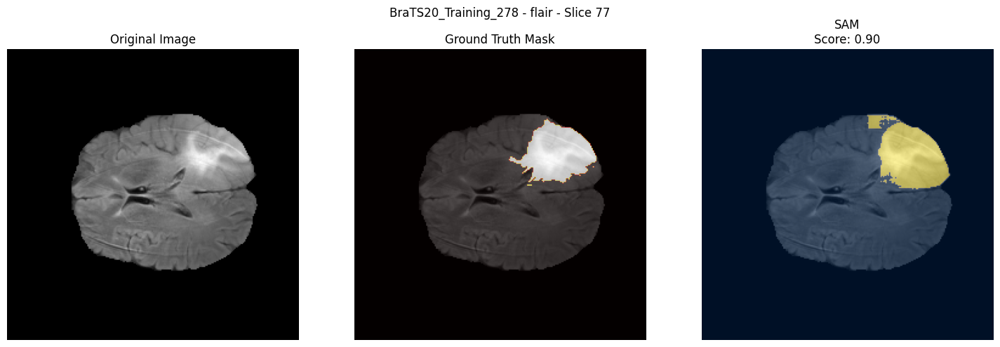

Dice Score: 0.8055 | IoU: 0.6743


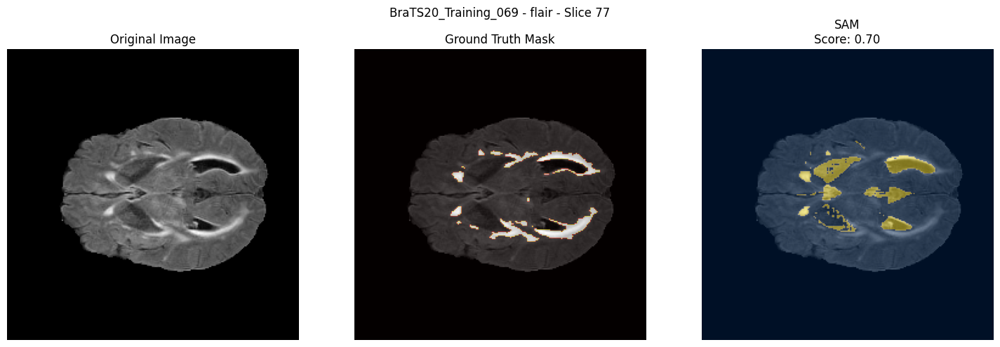

Dice Score: 0.1388 | IoU: 0.0746

Mean Dice Score: 0.6914
Mean IoU Score: 0.5706


In [15]:
def batch_process_with_gt(df, modality='flair', slice_index=77):
    dice_scores = []
    iou_scores = []
    for idx, row in train_df.sample(10).iterrows():
        result = process_slice_with_gt(row, modality, slice_index)
        if result is not None:
            gt_mask, sam_mask = result
            dice = calculate_dice(gt_mask, sam_mask)
            iou = calculate_iou(gt_mask, sam_mask)
            print(f"Dice Score: {dice:.4f} | IoU: {iou:.4f}")
            dice_scores.append(dice)
            iou_scores.append(iou)
    if dice_scores:
        print(f"\nMean Dice Score: {np.mean(dice_scores):.4f}")
        print(f"Mean IoU Score: {np.mean(iou_scores):.4f}")
    else:
        print("No valid slices found.")

# Call with your DataFrame
batch_process_with_gt(train_df, modality='flair', slice_index=77)

# Implementing SAM on Validation Dataset & Visualizing Ground Truth Mask along with SAM Generated Masks

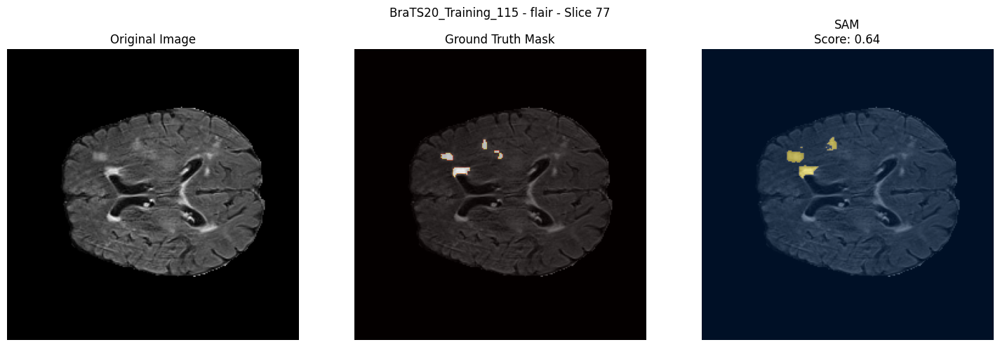

Dice Score: 0.6005 | IoU: 0.4290


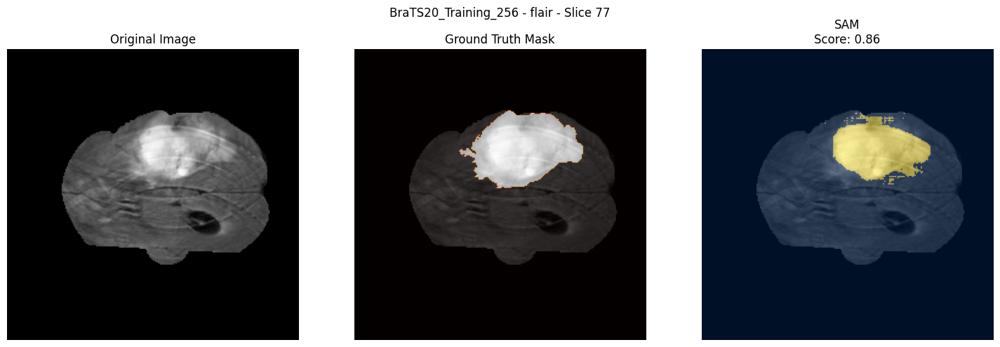

Dice Score: 0.7862 | IoU: 0.6478


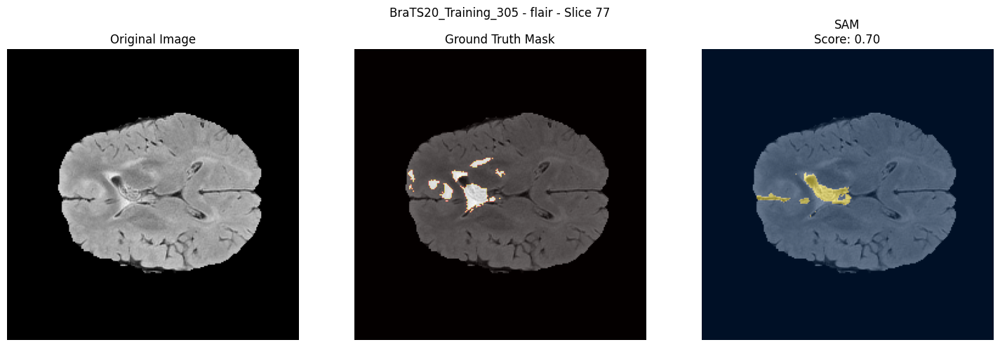

Dice Score: 0.3682 | IoU: 0.2256


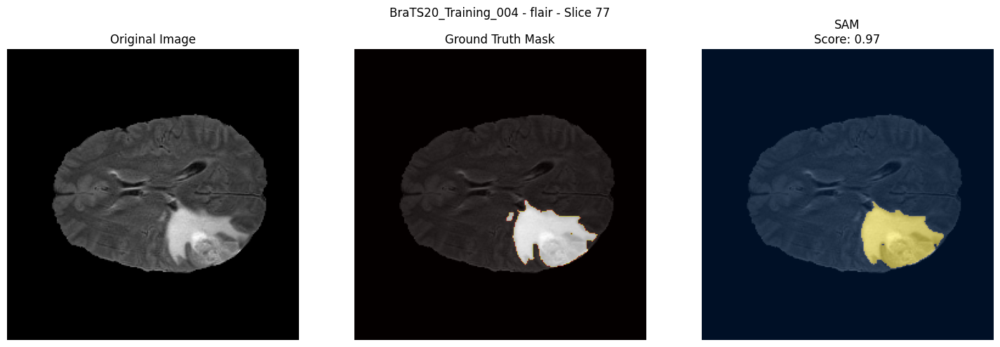

Dice Score: 0.9505 | IoU: 0.9056
No tumor in slice 77 of BraTS20_Training_204. Skipping.

Mean Dice Score: 0.6763
Mean IoU Score: 0.5520


In [16]:
def batch_process_with_gt(df, modality='flair', slice_index=77):
    dice_scores = []
    iou_scores = []
    for idx, row in valid_df.sample(5).iterrows():
        result = process_slice_with_gt(row, modality, slice_index)
        if result is not None:
            gt_mask, sam_mask = result
            dice = calculate_dice(gt_mask, sam_mask)
            iou = calculate_iou(gt_mask, sam_mask)
            print(f"Dice Score: {dice:.4f} | IoU: {iou:.4f}")
            dice_scores.append(dice)
            iou_scores.append(iou)
    if dice_scores:
        print(f"\nMean Dice Score: {np.mean(dice_scores):.4f}")
        print(f"Mean IoU Score: {np.mean(iou_scores):.4f}")
    else:
        print("No valid slices found.")

# Call with your DataFrame
batch_process_with_gt(valid_df, modality='flair', slice_index=77)

# Defining Real-Time Dataset to show the Model's Autheticity

In [17]:
import os
import pandas as pd

base_dir = '/kaggle/input/brain-tumor-segmentation-brats-2019/MICCAI_BraTS_2019_Data_Training/HGG'
all_patients = sorted(os.listdir(base_dir))

data_list = []
for patient_id in all_patients:
    patient_path = os.path.join(base_dir, patient_id)
    if os.path.isdir(patient_path):
        data_entry = {
            'patient_id': patient_id,
            'flair': os.path.join(patient_path, f'{patient_id}_flair.nii'),
            't1': os.path.join(patient_path, f'{patient_id}_t1.nii'),
            't1ce': os.path.join(patient_path, f'{patient_id}_t1ce.nii'),
            't2': os.path.join(patient_path, f'{patient_id}_t2.nii'),
            'seg': os.path.join(patient_path, f'{patient_id}_seg.nii'),
        }
        data_list.append(data_entry)

real_time_df = pd.DataFrame(data_list)
print(real_time_df.head())

          patient_id                                              flair  \
0  BraTS19_2013_10_1  /kaggle/input/brain-tumor-segmentation-brats-2...   
1  BraTS19_2013_11_1  /kaggle/input/brain-tumor-segmentation-brats-2...   
2  BraTS19_2013_12_1  /kaggle/input/brain-tumor-segmentation-brats-2...   
3  BraTS19_2013_13_1  /kaggle/input/brain-tumor-segmentation-brats-2...   
4  BraTS19_2013_14_1  /kaggle/input/brain-tumor-segmentation-brats-2...   

                                                  t1  \
0  /kaggle/input/brain-tumor-segmentation-brats-2...   
1  /kaggle/input/brain-tumor-segmentation-brats-2...   
2  /kaggle/input/brain-tumor-segmentation-brats-2...   
3  /kaggle/input/brain-tumor-segmentation-brats-2...   
4  /kaggle/input/brain-tumor-segmentation-brats-2...   

                                                t1ce  \
0  /kaggle/input/brain-tumor-segmentation-brats-2...   
1  /kaggle/input/brain-tumor-segmentation-brats-2...   
2  /kaggle/input/brain-tumor-segmentation-br

# Implementing SAM on Real-Time Dataset & Visualizing Ground Truth Mask along with SAM Generated Masks

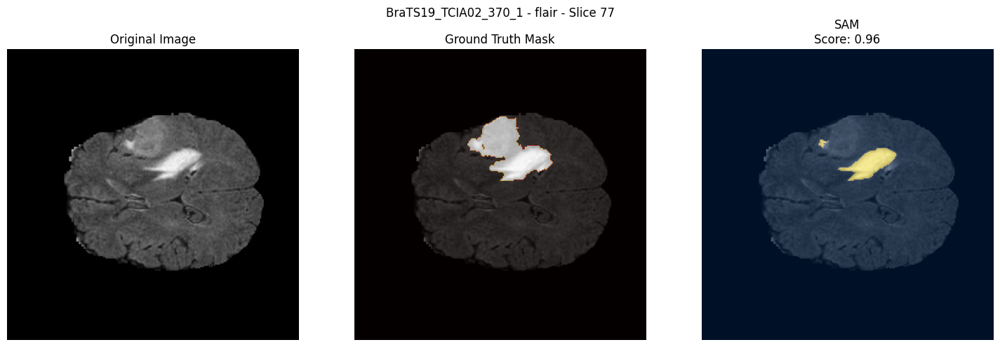

Dice Score: 0.5162 | IoU: 0.3479


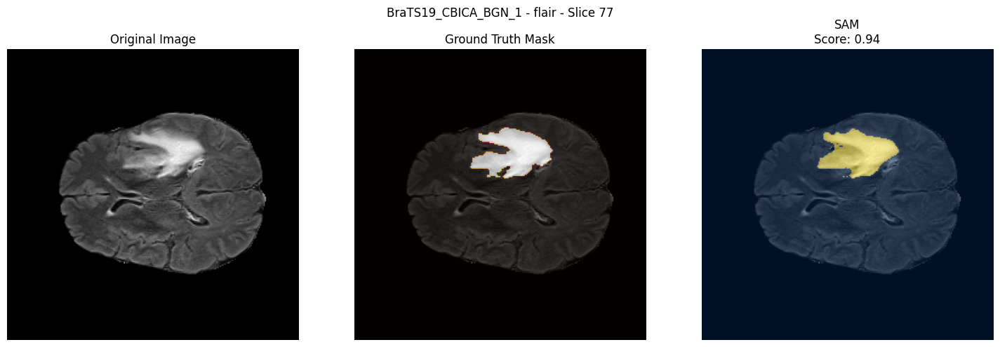

Dice Score: 0.8799 | IoU: 0.7855


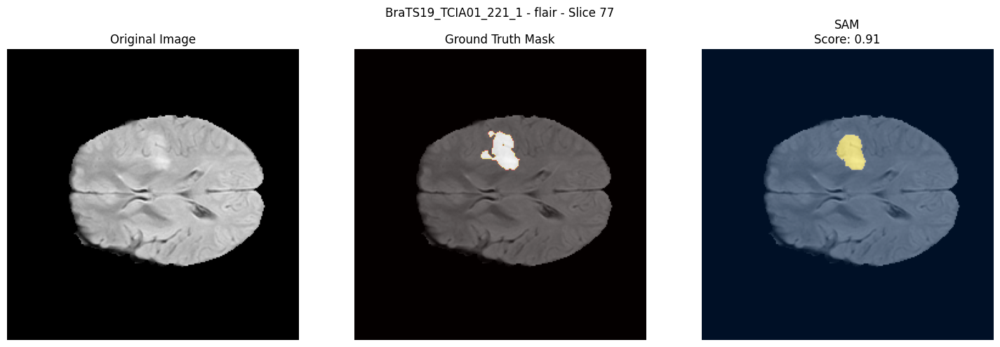

Dice Score: 0.8599 | IoU: 0.7542


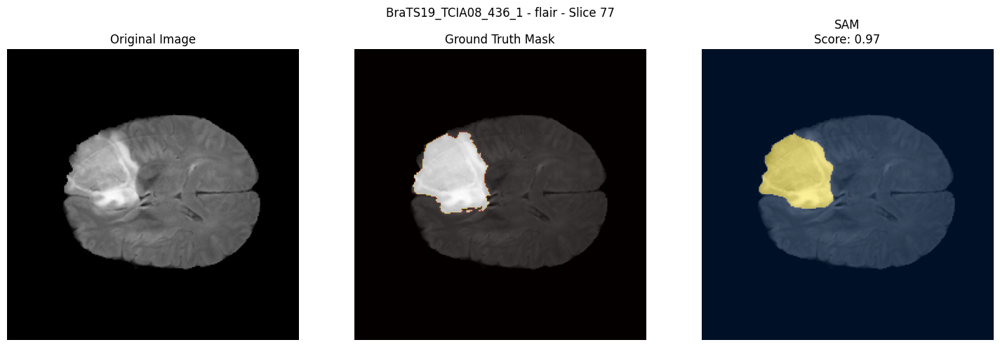

Dice Score: 0.9349 | IoU: 0.8777


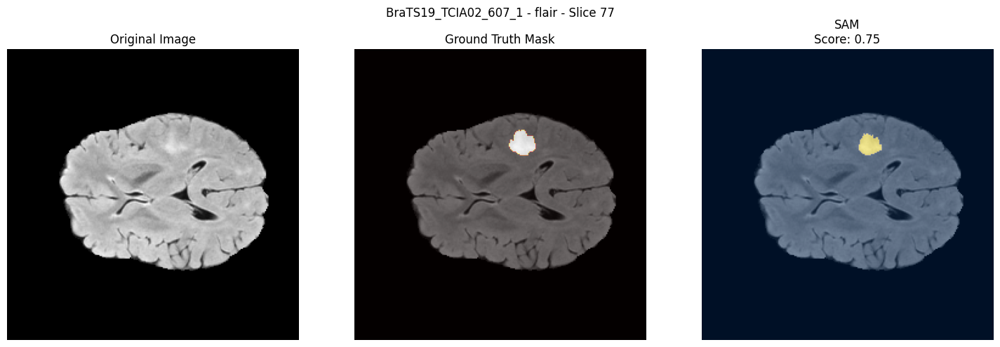

Dice Score: 0.8451 | IoU: 0.7317

Mean Dice Score: 0.8072
Mean IoU Score: 0.6994


In [18]:
def batch_process_with_gt(df, modality='flair', slice_index=77):
    dice_scores = []
    iou_scores = []
    for idx, row in real_time_df.sample(5).iterrows():
        result = process_slice_with_gt(row, modality, slice_index)
        if result is not None:
            gt_mask, sam_mask = result
            dice = calculate_dice(gt_mask, sam_mask)
            iou = calculate_iou(gt_mask, sam_mask)
            print(f"Dice Score: {dice:.4f} | IoU: {iou:.4f}")
            dice_scores.append(dice)
            iou_scores.append(iou)
    if dice_scores:
        print(f"\nMean Dice Score: {np.mean(dice_scores):.4f}")
        print(f"Mean IoU Score: {np.mean(iou_scores):.4f}")
    else:
        print("No valid slices found.")

# Call with your DataFrame
batch_process_with_gt(real_time_df, modality='flair', slice_index=77)